In [1]:
import os, sys
sys.path.append(os.path.dirname(os.getcwd()))
sys.path.append(os.path.dirname(os.path.dirname(os.getcwd())))

from glob import glob
import math
from pprint import pprint
import torch

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
import json
import random

from tqdm import tqdm
import trimesh

from ANALYSIS.analysis_utils import (
    plot_panel_info,
    visualize_meshes_plotly,
    # v_id_map
)

from env_constants import SEWFORMER_PROJ_ROOT, DATASET_ROOT, PYGARMENT_ROOT

sys.path.append(PYGARMENT_ROOT)

import pygarment as pyg

In [2]:
def filter_fn(path):
    if not os.path.isdir(path):
        print(f"{path} is not a directory")
        return False
    if not os.path.exists(os.path.join(path, "static", "spec_config.json")):
        print(f"No spec_config.json in {path}")
        return False
    return True


raw_combination_path_list = sorted(glob(os.path.join(DATASET_ROOT, "sewfactory", "*")))
combination_path_list = []
for garment_path in tqdm(raw_combination_path_list):
    if filter_fn(garment_path):
        combination_path_list.append(garment_path)
len(combination_path_list)

  0%|          | 0/13707 [00:00<?, ?it/s]

100%|██████████| 13707/13707 [00:00<00:00, 132226.58it/s]

No spec_config.json in /media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/tee_sleeveless_C2EFEDVIB0_wb_pants_straight_U3CBKG8WW1


13706

In [3]:
STOP_IDX = 10

for idx, combination_path in enumerate(combination_path_list) :
    spec_config_path = os.path.join(combination_path, "static", "spec_config.json")
    with open(spec_config_path, "r") as f:
        spec_config = json.load(open(spec_config_path, "r"))

    print(spec_config.keys())
    print(
        list(map(
            lambda x : x["spec"],
            spec_config.values()
        ))
    )
    
    if idx > STOP_IDX:
        break

dict_keys(['one_piece'])
['dress_sleeveless_2587\\dress_sleeveless_005CWF73E9']
dict_keys(['one_piece'])
['dress_sleeveless_2587\\dress_sleeveless_00F3PNYG6L']
dict_keys(['one_piece'])
['dress_sleeveless_7000_dress_sleeveless_221102-11-41-00\\dress_sleeveless_00M2CX1YWW']
dict_keys(['one_piece'])
['dress_sleeveless_2587\\dress_sleeveless_013LZJLUQ0']
dict_keys(['one_piece'])
['dress_sleeveless_7000_dress_sleeveless_221102-11-41-00\\dress_sleeveless_014TV5GC0X']
dict_keys(['one_piece'])
['dress_sleeveless_7000_dress_sleeveless_221102-11-41-00\\dress_sleeveless_01SGV2152F']
dict_keys(['one_piece'])
['dress_sleeveless_2587\\dress_sleeveless_02OIQPCOWU']
dict_keys(['one_piece'])
['dress_sleeveless_2587\\dress_sleeveless_02XDGBX5VN']
dict_keys(['one_piece'])
['dress_sleeveless_7000_dress_sleeveless_221102-11-41-00\\dress_sleeveless_03H2RT1URT']
dict_keys(['one_piece'])
['dress_sleeveless_2587\\dress_sleeveless_048BBSET3Z']
dict_keys(['one_piece'])
['dress_sleeveless_7000_dress_sleeveless_22

In [4]:
from analysis_utils import visualize_meshes_plotly

In [5]:
import json
import numpy as np
import smplx
import torch
import trimesh

SMPLH_PATH = os.path.join(
    SEWFORMER_PROJ_ROOT, "Sewformer", "assets",
)

# Create SMPL-H model
model = smplx.create(
    model_path=SMPLH_PATH,
    model_type='smplh',  # Specifically use SMPL-H
    ext='pkl',
    gender='female',
    use_pca=False,  # Important: disable PCA for hand poses
    batch_size=1,
)

## Mesh 분석
- 옷 Mesh 의 Y 좌표가 0보다 작은 경우가 있음

1699


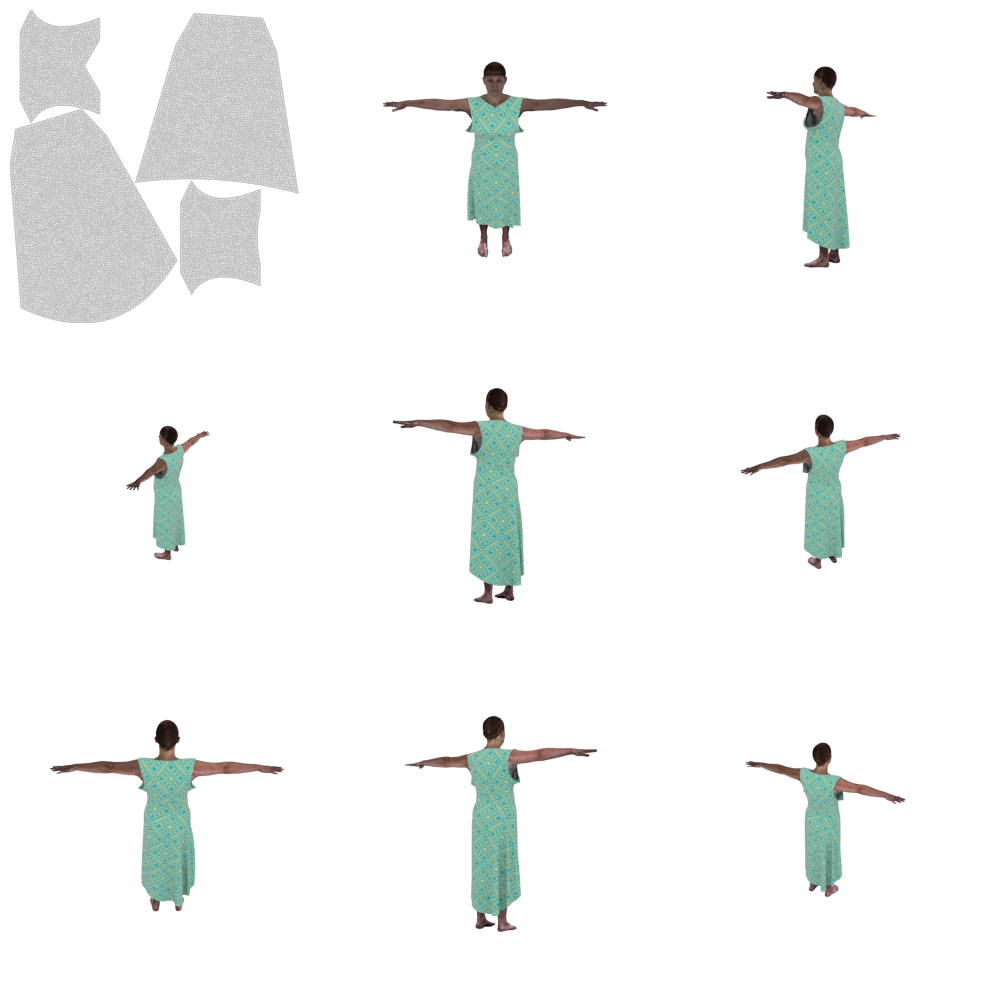

1699
165.37399888038635
[[ -1.1905867  77.87938   -23.810658 ]]
100


In [6]:
# Inspect "Static"

IDX = random.randint(0, len(combination_path_list))
print(IDX)

combination_path = combination_path_list[IDX]

static_camera_dict = {}
for camera_path in sorted(glob(os.path.join(combination_path, "static", "*cam_pos.json"))):
    with open(camera_path, "r") as f:
        camera_data = json.load(f)
    camera_name = os.path.basename(camera_path).replace("_cam_pos.json", "")
    static_camera_dict[camera_name] = camera_data
    

with open(os.path.join(combination_path, "static", "static__body_info.json"), "r") as f:
    static_body_data = json.load(f)
    betas = torch.tensor(static_body_data['shape'], dtype=torch.float32).unsqueeze(0)
    pose = torch.tensor(
        np.deg2rad(static_body_data['pose']),
        dtype=torch.float32
    ).unsqueeze(0)  # Shape: (1, 52, 3)
    transl = torch.tensor(static_body_data['trans'], dtype=torch.float32).unsqueeze(0)


    body_pose = pose[0, 1:22].reshape(1, -1)  # Body joints (excluding global orientation)
    left_hand_pose = pose[0, 22:37].reshape(1, -1)  # Left hand joints
    right_hand_pose = pose[0, 37:52].reshape(1, -1)  # Right hand joints
    global_orient = pose[0, 0].unsqueeze(0)  # Global orientation

    # Get body mesh
    output = model(
        betas=betas,
        body_pose=body_pose,
        global_orient=global_orient,
        left_hand_pose=left_hand_pose,
        right_hand_pose=right_hand_pose,
        # transl=transl
    )
    vertices = output.vertices.detach().numpy()[0]
    faces = model.faces

    # SCALE = 2 * transl.numpy()[0, 1] / (vertices[:, 1].max() - vertices[:, 1].min())
    SCALE = 100
    Z_OFFSET = -3
    Y_OFFSET = 21

    static_body_mesh = trimesh.Trimesh(vertices=vertices, faces=faces)
    static_body_mesh.apply_scale(SCALE)

    static_body_mesh.vertices += transl.numpy()
    # static_body_mesh.vertices[:, 1] -= static_body_mesh.vertices[:, 1].min()
    static_body_mesh.vertices[:, 2] += Z_OFFSET
    static_body_mesh.vertices[:, 1] += Y_OFFSET

static_img_path_list = sorted(glob(os.path.join(
    combination_path, "static", "*.png"
)))

static_garment_mesh_list = []
for mesh_path in glob(os.path.join(
    combination_path, "static", "*.obj"
)):
    static_garment_mesh_list.append(trimesh.load_mesh(mesh_path, process=False))

N_ROWS = 3
N_COLS = 3
plt.figure(figsize=(10, 10))
for i in range(N_ROWS * N_COLS):
    plt.subplot(N_ROWS, N_COLS, i + 1)
    plt.imshow(Image.open(static_img_path_list[i]))
    plt.axis('off')
plt.tight_layout()
plt.show()

cam_T_list = list(map(
    lambda x : np.array(x["cam_T"]).reshape(1, 3),
    static_camera_dict.values()
))

# visualize_meshes_plotly(
#     [static_body_mesh] + static_garment_mesh_list,
#     # [body_mesh["mesh"] for body_mesh in body_dict.values()],
#     show_edges=False,
#     # vertices_list=cam_T_list,
#     # vertices_color_list=["red"]*len(cam_T_list)
# )
print(IDX)

print(static_body_mesh.vertices[:, 1].max() - static_body_mesh.vertices[:, 1].min())

print(transl.numpy())
print(SCALE)

## Render

4303


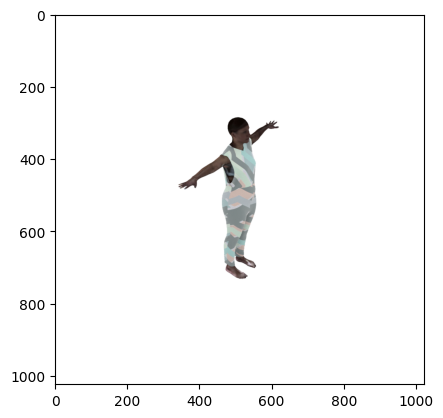

4303
157.25945234298706
[[-172.45824    83.17317   -21.742273]]
100
static_300_30cam_pos.json
/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/jumpsuit_sleeveless_O7JIX3WRES/static/static_300_30.png


In [19]:
# Inspect "Static"

IDX = random.randint(0, len(combination_path_list))
print(IDX)

combination_path = combination_path_list[IDX]

static_camera_dict = {}
for camera_path in sorted(glob(os.path.join(combination_path, "static", "*cam_pos.json"))):
    with open(camera_path, "r") as f:
        camera_data = json.load(f)
    camera_name = os.path.basename(camera_path).replace("_cam_pos.json", "")
    static_camera_dict[camera_name] = camera_data
    

with open(os.path.join(combination_path, "static", "static__body_info.json"), "r") as f:
    static_body_data = json.load(f)
    betas = torch.tensor(static_body_data['shape'], dtype=torch.float32).unsqueeze(0)
    pose = torch.tensor(
        np.deg2rad(static_body_data['pose']),
        dtype=torch.float32
    ).unsqueeze(0)  # Shape: (1, 52, 3)
    transl = torch.tensor(static_body_data['trans'], dtype=torch.float32).unsqueeze(0)

    body_pose = pose[0, 1:22].reshape(1, -1)  # Body joints (excluding global orientation)
    left_hand_pose = pose[0, 22:37].reshape(1, -1)  # Left hand joints
    right_hand_pose = pose[0, 37:52].reshape(1, -1)  # Right hand joints
    global_orient = pose[0, 0].unsqueeze(0)  # Global orientation

    # Get body mesh
    output = model(
        betas=betas,
        body_pose=body_pose,
        global_orient=global_orient,
        left_hand_pose=left_hand_pose,
        right_hand_pose=right_hand_pose,
        # transl=transl
    )
    vertices = output.vertices.detach().numpy()[0]
    faces = model.faces

    # SCALE = 2 * transl.numpy()[0, 1] / (vertices[:, 1].max() - vertices[:, 1].min())
    SCALE = 100
    Z_OFFSET = -3
    Y_OFFSET = 21

    static_body_mesh = trimesh.Trimesh(vertices=vertices, faces=faces)
    static_body_mesh.apply_scale(SCALE)

    static_body_mesh.vertices += transl.numpy()
    # static_body_mesh.vertices[:, 1] -= static_body_mesh.vertices[:, 1].min()
    static_body_mesh.vertices[:, 2] += Z_OFFSET
    static_body_mesh.vertices[:, 1] += Y_OFFSET


static_garment_mesh_list = []
for mesh_path in glob(os.path.join(
    combination_path, "static", "*.obj"
)):
    static_garment_mesh_list.append(trimesh.load_mesh(mesh_path, process=False))


static_cam_name = list(static_camera_dict.keys())[
    random.randint(0, len(static_camera_dict) - 1)
]

cam = static_camera_dict[static_cam_name]

cam_T = np.array(cam["cam_T"]).reshape(1, 3)
cam_R = np.array(cam["cam_R"])

cam_pose = np.eye(4)
cam_pose[:3, 3] = cam_T
cam_pose[:3, :3] = cam_R

static_img_path = os.path.join(
    combination_path, "static", f"{static_cam_name.replace('cam_pos.json', '.png')}"
)
plt.imshow(Image.open(static_img_path))
plt.show()

visualize_meshes_plotly(
    [static_body_mesh] + static_garment_mesh_list,
    show_edges=False,
    vertices_list=[cam_T],
    vertices_color_list=["red"]
)
print(IDX)

print(static_body_mesh.vertices[:, 1].max() - static_body_mesh.vertices[:, 1].min())

print(transl.numpy())
print(SCALE)
print(static_cam_name)
print(static_img_path)

In [8]:
list(map(
    lambda x : np.array(x["cam_T"]).reshape(1, 3),
    static_camera_dict.values()
))

[array([[-66.83191872, 255.23330082, 256.43688221]]),
 array([[ 262.38816109,   74.59027995, -246.52130967]]),
 array([[ 320.48618845,  332.8023514 , -280.06422141]]),
 array([[ 110.31120389,   74.59027995, -363.26689654]]),
 array([[ 126.67123089,  298.02847098, -391.60329452]]),
 array([[ -66.83191872,  255.23330082, -369.32889816]]),
 array([[-243.97504132,   74.59027995, -363.26689654]]),
 array([[-260.33506832,  298.02847098, -391.60329452]]),
 array([[-396.05199852,   74.59027995, -246.52130967]]),
 array([[-454.15002588,  332.8023514 , -280.06422141]]),
 array([[-524.30407924,  338.71195498,  -56.44600797]]),
 array([[-396.05199852,   74.59027995,  133.62929372]]),
 array([[-454.15002588,  332.8023514 ,  167.17220546]]),
 array([[110.31120389,  74.59027995, 250.37488059]]),
 array([[126.67123089, 298.02847098, 278.71127857]]),
 array([[-243.97504132,   74.59027995,  250.37488059]]),
 array([[-260.33506832,  298.02847098,  278.71127857]]),
 array([[262.38816109,  74.59027995, 133

In [9]:
static_camera_dict["static_0_30cam_pos.json"]

{'cam_T': [-66.83191871643066, 255.2333008247553, 256.4368822070053],
 'cam_K': [[1493.3363200059732, 0.0, 512.0],
  [0.0, 1493.3363200059732, 512.0],
  [0.0, 0.0, 1.0]],
 'cam_R': [[1.0, 0.0, 0.0],
  [0.0, 0.8660254037844387, 0.49999999999999994],
  [0.0, -0.49999999999999994, 0.8660254037844387]]}

In [10]:
cam = list(static_camera_dict.values())[0]
cam_T = np.array(cam["cam_T"]).reshape(1, 3)
cam_R = np.array(cam["cam_R"])

cam_pose = np.eye(4)
cam_pose[:3, 3] = cam_T
cam_pose[:3, :3] = cam_R

cam_pose = np.linalg.inv(cam_pose)

cam_K = np.array(cam["cam_K"])
fx = fy = cam_K[0, 0]
cx = cam_K[0, 2]
cy = cam_K[1, 2]









In [11]:

import os
import platform
if platform.system() == 'Linux':
    os.environ["PYOPENGL_PLATFORM"] = "egl"
os.environ["PYOPENGL_PLATFORM"] = "egl"
os.environ['MESA_GL_VERSION_OVERRIDE'] = '4.1' 
os.environ['MESA_GLSL_VERSION_OVERRIDE'] = '410'

import pyrender

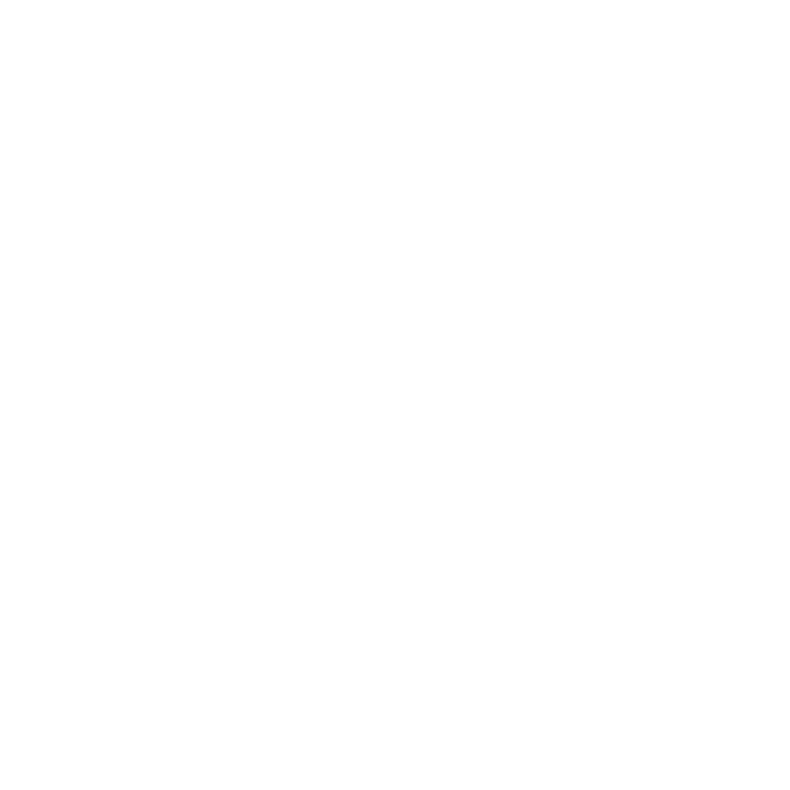

In [12]:

scene = pyrender.Scene(bg_color=[1.0, 1.0, 1.0, 0.0])


pyrender_body_mesh = pyrender.Mesh.from_trimesh(static_body_mesh)
pyrender_garment_mesh_list = [pyrender.Mesh.from_trimesh(mesh) for mesh in static_garment_mesh_list]

scene.add(pyrender_body_mesh)
for pyrender_garment_mesh in pyrender_garment_mesh_list:
    scene.add(pyrender_garment_mesh)


cam = list(static_camera_dict.values())[0]
cam_T = np.array(cam["cam_T"]).reshape(1, 3)
cam_R = np.array(cam["cam_R"])

cam_pose = np.eye(4)
cam_pose[:3, 3] = cam_T
cam_pose[:3, :3] = cam_R

cam_pose = np.linalg.inv(cam_pose)

cam_K = np.array(cam["cam_K"])
fx = fy = cam_K[0, 0]
cx = cam_K[0, 2]
cy = cam_K[1, 2]


pyrender_cam = pyrender.IntrinsicsCamera(fx, fy, cx, cy)
scene.add(pyrender_cam, pose=cam_pose)



light = pyrender.DirectionalLight(color=np.ones(3), intensity=2.0)
scene.add(light, pose=cam_pose)

# Create off-screen renderer
r = pyrender.OffscreenRenderer(
    viewport_width=1024, viewport_height=1024
)

# Render scene
color, depth = r.render(scene)

# Display the rendered image
plt.figure(figsize=(10, 10))
plt.imshow(color)
plt.axis('off')
plt.show()

# Clean up
r.delete()

In [114]:
np.__version__

'2.0.2'

3264


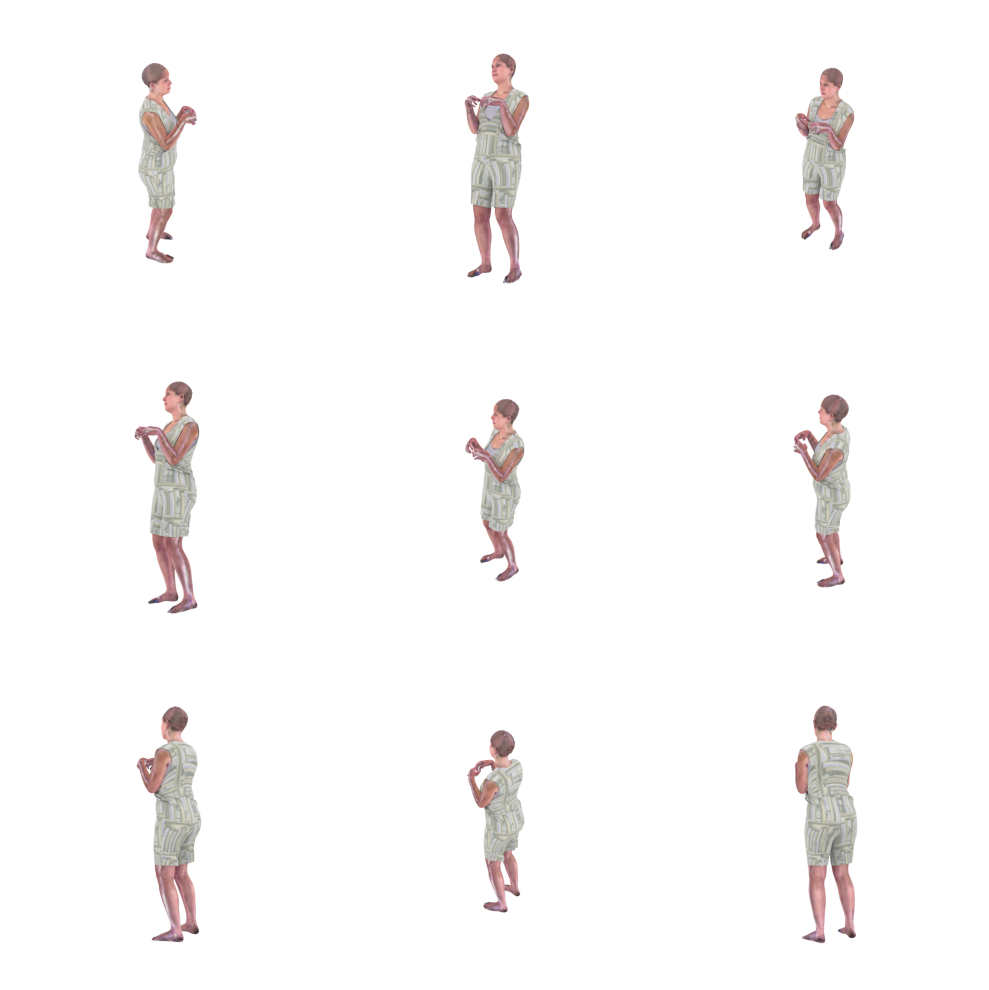

{'-0050': {'mesh': <trimesh.Trimesh(vertices.shape=(6890, 3), faces.shape=(13776, 3))>,
           'name': '-0050__body_info',
           'path': '/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/jumpsuit_sleeveless_I5KJ949ODA/poses/-0050__body_info.json'},
 '0000': {'mesh': <trimesh.Trimesh(vertices.shape=(6890, 3), faces.shape=(13776, 3))>,
          'name': '0000__body_info',
          'path': '/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/jumpsuit_sleeveless_I5KJ949ODA/poses/0000__body_info.json'}}
0000


3264


In [108]:
IDX = random.randint(0, len(combination_path_list))
print(IDX)

combination_path = combination_path_list[IDX]


static_camera_dict = {}
for camera_path in sorted(glob(os.path.join(combination_path, "static", "*cam_pos.json"))):
    with open(camera_path, "r") as f:
        camera_data = json.load(f)
    camera_name = os.path.basename(camera_path).replace("_cam_pos.json", "")
    static_camera_dict[camera_name] = camera_data
    
camera_dict = {}
for camera_path in sorted(glob(os.path.join(combination_path, "renders", "*cam_pos.json"))):
    with open(camera_path, "r") as f:
        camera_data = json.load(f)
    camera_name = os.path.basename(camera_path).replace("_cam_pos.json", "")
    camera_dict[camera_name] = camera_data


body_dict = {}
for body_path in sorted(glob(os.path.join(combination_path, "poses", "*.json"))):
    body_name = os.path.basename(body_path).replace(".json", "").split("__")[0]
    with open(body_path, "r") as f:
        body_data = json.load(f)

    betas = torch.tensor(body_data['shape'], dtype=torch.float32).unsqueeze(0)
    pose = torch.tensor(
        np.deg2rad(body_data['pose']),
        dtype=torch.float32
    ).unsqueeze(0)  # Shape: (1, 52, 3)
    transl = torch.tensor(body_data['trans'], dtype=torch.float32).unsqueeze(0)


    # For SMPL-H, we need to split the pose parameters:
    # - First 22 joints (66 values) are for body
    # - Remaining 30 joints are for hands (15 per hand)
    body_pose = pose[0, 1:22].reshape(1, -1)  # Body joints (excluding global orientation)
    left_hand_pose = pose[0, 22:37].reshape(1, -1)  # Left hand joints
    right_hand_pose = pose[0, 37:52].reshape(1, -1)  # Right hand joints
    global_orient = pose[0, 0].unsqueeze(0)  # Global orientation

    # Get body mesh
    output = model(
        betas=betas,
        body_pose=body_pose,
        global_orient=global_orient,
        left_hand_pose=left_hand_pose,
        right_hand_pose=right_hand_pose,
        # transl=transl
    )

    # Get vertices and faces
    vertices = output.vertices.detach().numpy()[0]
    faces = model.faces

    body_mesh = trimesh.Trimesh(vertices=vertices, faces=faces)
    body_mesh.apply_scale(100)
    
    body_mesh.vertices += transl.numpy()
    
    ## Fucking Guess
    body_mesh.vertices -= body_mesh.vertices[:, 1].min()

    
    body_dict[body_name] = {
        "name" : os.path.basename(body_path).replace(".json", ""),
        "path" : body_path,
        "mesh" : body_mesh,
    }


vis_pose_name = random.sample(list(body_dict.keys()), 1)[0]


img_path_list = sorted(glob(os.path.join(
    combination_path, "renders", f"{vis_pose_name}*.png"
)))

garment_mesh_list = []
for mesh_path in glob(os.path.join(
    combination_path, "objects", f"*_{int(vis_pose_name)}.obj"
)):
    garment_mesh_list.append(trimesh.load_mesh(mesh_path, process=False))

N_ROWS = 3
N_COLS = 3
plt.figure(figsize=(10, 10))
for i in range(N_ROWS * N_COLS):
    plt.subplot(N_ROWS, N_COLS, i + 1)
    plt.imshow(Image.open(img_path_list[i]))
    plt.axis('off')
plt.tight_layout()
plt.show()

pprint(body_dict)
print(vis_pose_name)

visualize_meshes_plotly(
    [body_mesh] + garment_mesh_list,
    # [body_mesh["mesh"] for body_mesh in body_dict.values()],
    show_edges=False
)
print(IDX)

In [107]:
# static_camera_dict

In [125]:
5675
10915
6848
6248


10915

In [106]:
betas.shape

torch.Size([1, 10])

In [85]:
random.sample(list(body_dict.keys()), 1)

['-0050']

In [68]:

IDX = random.randint(0, len(combination_path_list))

print(IDX)

combination_path = combination_path_list[IDX]


SMPLH_PATH = os.path.join(
    SEWFORMER_PROJ_ROOT, "Sewformer", "assets",
)

# with open(os.path.join(combination_path, "static", f"static__body_info.json"), "r") as f:
#     body_data = json.load(f)

body_dict = {}
for body_path in sorted(glob(os.path.join(combination_path, "poses", "*.json"))):
    with open(body_path, "r") as f:
        body_data = json.load(f)
    body_name = int(
        os.path.basename(body_path).replace(".json", "").split("__")[0]
    )
    
    
    body_dict[body_name] = {
        "name" : os.path.basename(body_path).replace(".json", ""),
        "path" : body_path,
    }

pprint(body_dict)

3763
{-50: {'name': '-0050__body_info',
       'path': '/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/jumpsuit_sleeveless_L1H29Z7VJ0/poses/-0050__body_info.json'},
 0: {'name': '0000__body_info',
     'path': '/media/hjp/05aba9a7-0e74-4e54-9bc9-5f11b9c4c757/SewFactory/sewfactory/sewfactory/jumpsuit_sleeveless_L1H29Z7VJ0/poses/0000__body_info.json'}}


In [24]:
IDX = random.randint(0, len(combination_path_list))

combination_path = combination_path_list[IDX]
spec_config_path = os.path.join(combination_path, "static", "spec_config.json")
with open(spec_config_path, "r") as f:
    spec_config = json.load(open(spec_config_path, "r"))

print(spec_config.keys())
print(
    list(map(
        lambda x : os.path.basename(x["spec"].replace("\\", "/")),
        spec_config.values()
    ))
)
print(
    list(map(
        os.path.basename,
        glob(os.path.join(garment_path, "static", "*specification.json"))
    ))
)




garment_name_list = list(map(
    lambda x : os.path.basename(x["spec"].replace("\\", "/")),
    spec_config.values()
))

with open(os.path.join(combination_path, "static", f"static__body_info.json"), "r") as f:
    body_info = json.load(f)

print(body_info.keys())
pprint(np.array(body_info["pose"]).shape)
pprint(np.array(body_info["shape"]).shape)
pprint(np.array(body_info["trans"]).shape)

for garment_name in garment_name_list :
    pprint(
        list(map(
            os.path.basename,
            sorted(glob(os.path.join(
                combination_path, "static", "static*png"
            )))
        ))
    )
    


dict_keys(['top', 'bottom'])
['tee_JOLPOGDU9V', 'skirt_4_panels_23W5S9RVEU']
['wb_dress_sleeveless_ZYWMJ5QUQ9_specification.json']
dict_keys(['shape', 'trans', 'pose'])
(52, 3)
(10,)
(3,)
['static_0_30.png',
 'static_120_0.png',
 'static_120_30.png',
 'static_150_0.png',
 'static_150_30.png',
 'static_180_30.png',
 'static_210_0.png',
 'static_210_30.png',
 'static_240_0.png',
 'static_240_30.png',
 'static_270_30.png',
 'static_300_0.png',
 'static_300_30.png',
 'static_30_0.png',
 'static_30_30.png',
 'static_330_0.png',
 'static_330_30.png',
 'static_60_0.png',
 'static_60_30.png',
 'static_90_30.png',
 'static_back.png',
 'static_front.png',
 'static_left.png',
 'static_right.png']
['static_0_30.png',
 'static_120_0.png',
 'static_120_30.png',
 'static_150_0.png',
 'static_150_30.png',
 'static_180_30.png',
 'static_210_0.png',
 'static_210_30.png',
 'static_240_0.png',
 'static_240_30.png',
 'static_270_30.png',
 'static_300_0.png',
 'static_300_30.png',
 'static_30_0.png',
 'stat

In [4]:
panel_svg_path_dict

NameError: name 'panel_svg_path_dict' is not defined

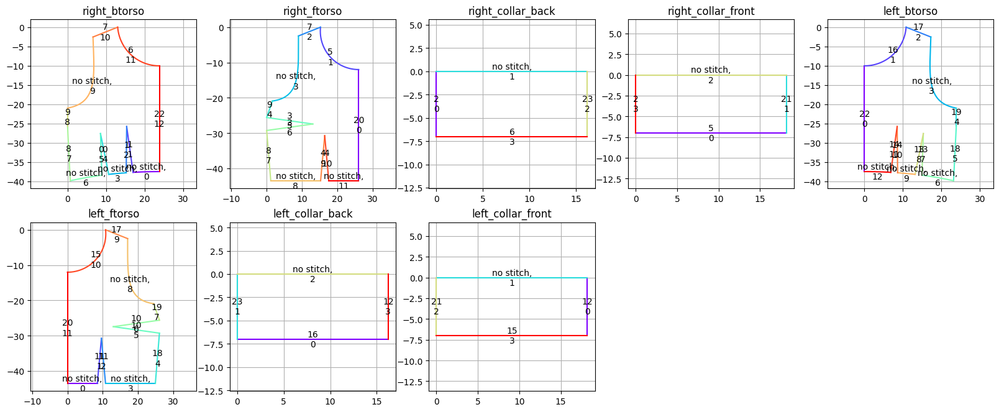

In [14]:
panel_svg_path_dict = {
    panel_name : pattern._draw_a_panel(
        panel_name, apply_transform=False, fill=True
    )
    for panel_name in pattern.panel_order()
}
stitch_dict = {
    i : v for i, v in enumerate(pattern.pattern['stitches'])
}

FIGLEN = 4
NCOLS = int(np.sqrt(len(panel_svg_path_dict)))
NROWS = int(np.ceil(len(panel_svg_path_dict) / NCOLS))
NCOLS = 5
NROWS = 3

plt.figure(figsize=(FIGLEN * NCOLS, FIGLEN * NROWS))
for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
    ax = plt.subplot(NROWS, NCOLS, i + 1)
    ax.set_title(panel_name)
    plot_panel_info(
        ax, panel_name, panel_svg_path_dict, stitch_dict,
        N_SAMPLES=1000
    )
# plt.savefig(f"{garment_id}_panel_vis.png")
plt.show()

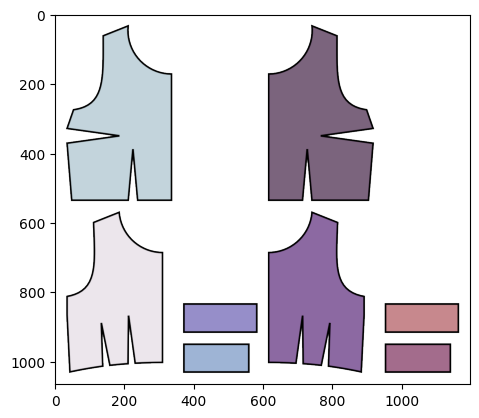

In [4]:
plt.imshow(Image.open(os.path.join(garment_path, f"{garment_id}_texture.png")))
plt.show()

# for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
#     fig, ax = plt.subplots()
#     ax.set_title(panel_name)
#     plot_panel_info(
#         ax, panel_name, panel_svg_path_dict, stitch_dict,
#         N_SAMPLES=1000
#     )
#     plt.show()
# for i, (panel_name, panel) in enumerate(panel_svg_path_dict.items()):
#     fig, ax = plt.subplots()
#     ax.set_title(panel_name)
#     plot_panel_info(
#         ax, panel_name, panel_svg_path_dict, stitch_dict,
#         N_SAMPLES=1000
#     )
#     plt.show()


In [5]:

simulated_garment_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_sim.ply"),
    process=False
)
simulated_garment_mesh.vertices = simulated_garment_mesh.vertices / 100


tex_image = Image.open(os.path.join(garment_path, f"{garment_id}_texture.png"))
texture = trimesh.visual.TextureVisuals(
    simulated_garment_mesh.visual.uv,
    image=tex_image
)
simulated_garment_mesh.visual = texture

print("vertices", simulated_garment_mesh.vertices.shape)
print("faces", simulated_garment_mesh.faces.shape)

idx_convert_map = np.array(v_id_map(simulated_garment_mesh.vertices))

# Read Vertex Label
with open(os.path.join(garment_path, f"{garment_id}_sim_segmentation.txt"), "r") as f:
    segmentation = list(map(
        lambda x : x.strip(),
        f.readlines()
    ))

panel_vertex_mask_dict = {}
for k in panel_svg_path_dict.keys():
    raw_mask = list(map(
        lambda x : True if x.startswith(k) else False,
        segmentation
    ))
    panel_vertex_mask_dict[k] = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    

stitch_vertex_mask_dict = {}
for k in stitch_dict.keys():
    raw_mask = list(map(
        lambda x : True if f"stitch_{k}" in x.split(",") else False,
        segmentation
    ))
    base_mask = np.array(list(map(
        lambda idx : True if raw_mask[idx] else False,
        idx_convert_map
    )))
    stitch_vertex_mask_dict[k] = base_mask
    
    
# visualize_meshes_plotly(
#     [
#         simulated_garment_mesh,
#         default_body_mesh
#     ],
#     color_list=["red", "blue"],
#     vertices_list=[
#         simulated_garment_mesh.vertices[
#             # panel_vertex_mask_dict["left_ftorso"]
#             stitch_vertex_mask_dict[24]
#         ]
#     ],
#     vertices_color_list=["yellow"],
# )

vertices (4610, 3)
faces (8320, 3)


In [6]:
for k, v in stitch_dict.items():
    panels = [v[0]['panel'], v[1]['panel']]
    if "left_ftorso" in panels and "right_ftorso" in panels:
        print(k)

20


In [7]:

box_mesh = trimesh.load_mesh(
    os.path.join(garment_path, f"{garment_id}_boxmesh.ply"),
    process=False
)
box_mesh.vertices = box_mesh.vertices / 100


tex_image = Image.open(os.path.join(garment_path, f"{garment_id}_texture.png"))
texture = trimesh.visual.TextureVisuals(
    box_mesh.visual.uv,
    image=tex_image
)
box_mesh.visual = texture

print("vertices", box_mesh.vertices.shape)
print("faces", box_mesh.faces.shape)

idx_convert_map = np.array(v_id_map(box_mesh.vertices))

# visualize_meshes_plotly(
#     [
#         box_mesh,
#         default_body_mesh
#     ],
#     color_list=["red", "blue"],
#     # vertex_list=simulated_garment_mesh.vertices[stitch_vertex_mask_dict[0]]
#     # vertex_list=simulated_garment_mesh.vertices[panel_vertex_mask_dict["left_ftorso"]]
#     vertices_list=[box_mesh.vertices],
#     vertices_color_list = ["black"]
# )

vertices (4610, 3)
faces (8320, 3)


In [8]:
QUERY_VERTEX_IDX = idx_convert_map.max()
QUERY_VERTEX_IDX = 5
same_vertex_idx_list = []

filtered_vertex_idx = idx_convert_map[QUERY_VERTEX_IDX]

same_vertex_idx_list = np.where(
    np.array(idx_convert_map) == filtered_vertex_idx
)[0]
print("QUERY_VERTEX_IDX    ", QUERY_VERTEX_IDX)
print("filtered_vertex_idx ", filtered_vertex_idx)
print("same_vertex_idx_list", same_vertex_idx_list)

print(idx_convert_map[same_vertex_idx_list])
print(idx_convert_map[QUERY_VERTEX_IDX])
print(idx_convert_map[:QUERY_VERTEX_IDX + 1])

QUERY_VERTEX_IDX     5
filtered_vertex_idx  3
same_vertex_idx_list [5 6]
[3 3]
3
[0 1 1 2 2 3]


## Processing
- Some vertices (Stitch Vertices) are duplicated.
- I have to Reorder Seam Vertices Path 

In [9]:
full_vertices = np.array(simulated_garment_mesh.vertices)
full_edges = np.array(simulated_garment_mesh.edges)
full_faces = np.array(simulated_garment_mesh.faces)

filtered2full_idx_map = {}
for idx, filtered_idx in enumerate(idx_convert_map):
    if filtered_idx in filtered2full_idx_map :
        filtered2full_idx_map[filtered_idx].append(idx)
    else:
        filtered2full_idx_map[filtered_idx] = [idx]

filtered_idx_list = []
filtered_vertices = []
for full_idx, filtered_idx in enumerate(idx_convert_map):
    if filtered_idx in filtered_idx_list:
        continue
    filtered_idx_list.append(filtered_idx)
    filtered_vertices.append(full_vertices[full_idx])
filtered_vertices = np.array(filtered_vertices)

filtered_edges = []
for idx, orig_edge in enumerate(full_edges):
    filtered_edge = np.array([
        idx_convert_map[orig_edge[0]],
        idx_convert_map[orig_edge[1]]
    ])
    
    # if len(filtered_edges) == 0:
    #     filtered_edges.append(filtered_edge)
    #     continue
    
    # if not  np.logical_or(
    #     (np.array(filtered_edges) == filtered_edge[0]).sum(axis=1) == 1,
    #     (np.array(filtered_edges) == filtered_edge[1]).sum(axis=1) == 1
    # ).sum() :
    #     filtered_edges.append(filtered_edge)
    filtered_edges.append(filtered_edge)
filtered_edges = np.array(filtered_edges)

filtered_faces = []
for idx, orig_face in enumerate(full_faces):
    filtered_face = np.array([
        idx_convert_map[orig_face[0]],
        idx_convert_map[orig_face[1]],
        idx_convert_map[orig_face[2]]
    ])

    # if len(filtered_faces) == 0:
    #     filtered_faces.append(filtered_face)
    #     continue 
    
    # if not np.logical_or(
    #     (np.array(filtered_faces) == filtered_face[0]).sum(axis=1) == 1,
    #     (np.array(filtered_faces) == filtered_face[1]).sum(axis=1) == 1,
    #     (np.array(filtered_faces) == filtered_face[2]).sum(axis=1) == 1
    # ).sum() :
    #     filtered_faces.append(filtered_face)
    filtered_faces.append(filtered_face)

In [10]:
full_edges.shape, filtered_edges.shape

((24960, 2), (24960, 2))

## Make Filtered Mesh

In [11]:


full_vertices = np.array(simulated_garment_mesh.vertices)
full_edges = np.array(simulated_garment_mesh.edges)
full_faces = np.array(simulated_garment_mesh.faces)

filtered2full_idx_map = {}
for idx, filtered_idx in enumerate(idx_convert_map):
    if filtered_idx in filtered2full_idx_map :
        filtered2full_idx_map[filtered_idx].append(idx)
    else:
        filtered2full_idx_map[filtered_idx] = [idx]

filtered_edges = []
for orig_edge in full_edges:
    stt = idx_convert_map[orig_edge[0]]
    end = idx_convert_map[orig_edge[1]]
    filtered_edges.append([stt, end])
    # is_exists= False
    # for prev in filtered_edges:
    #     if (
    #         prev[0] == stt and prev[1] == end
    #     ) or (
    #         prev[0] == end and prev[1] == stt
    #     ):
    #         is_exists = True
    #         break
    # if not is_exists:
    #     filtered_edges.append([stt, end])
filtered_edges = np.array(filtered_edges)

filtered_faces = []
for idx, orig_face in enumerate(full_faces):
    
    v1, v2, v3 = sorted([
        idx_convert_map[orig_face[0]],
        idx_convert_map[orig_face[1]],
        idx_convert_map[orig_face[2]]
    ])
    filtered_faces.append([v1, v2, v3])
    # is_exists = False
    # for prev in filtered_faces:
    #     prev_v1, prev_v2, prev_v3 = sorted(prev)
        
    #     if prev_v1 == v1 and prev_v2 == v2 and prev_v3 == v3:
    #         is_exists = True
    #         break
    # if not is_exists:
    #     filtered_faces.append([v1, v2, v3])
    
filtered_faces = np.array(filtered_faces)


filtered_mesh = trimesh.Trimesh(
    vertices=filtered_vertices,
    edges=filtered_edges,
    faces=filtered_faces,
    process=False
)


filtered_stitch_vertex_mask_dict = {}
for stitch_idx in stitch_vertex_mask_dict.keys():
    filtered_stitch_vertex_mask_dict[stitch_idx] = np.array(
        [False] * len(filtered_vertices)
    )
    for orig_vert_idx, val in enumerate(stitch_vertex_mask_dict[stitch_idx]):
        if val:
            filtered_vert_idx = idx_convert_map[orig_vert_idx]
            filtered_stitch_vertex_mask_dict[stitch_idx][filtered_vert_idx] = True


STITCH_IDX = 0
visualize_meshes_plotly(
    [filtered_mesh,],
    vertices_list=[
        filtered_mesh.vertices[filtered_stitch_vertex_mask_dict[STITCH_IDX]]
    ],
    vertices_color_list=["red"],
    vertex_marker_size=5
)


In [12]:
fltrd_vis_seam_line_dict = {}
fltrd_stch_vert_edge_connect_dict = {}
for fltrd_stch_idx in filtered_stitch_vertex_mask_dict.keys():
    fltrd_stch_vert_map = filtered_stitch_vertex_mask_dict[fltrd_stch_idx]
    fltrd_stch_vert_idx_arr = np.where(fltrd_stch_vert_map)[0]
    
    adj_dict = {}
    for v1, v2 in filtered_edges:
        if v1 in fltrd_stch_vert_idx_arr and v2 in fltrd_stch_vert_idx_arr:
            if v1 not in adj_dict: adj_dict[v1] = set()
            if v2 not in adj_dict: adj_dict[v2] = set()
            adj_dict[v1].add(v2)
            adj_dict[v2].add(v1)
    
    endpoints = [
        v for v in fltrd_stch_vert_idx_arr if len(adj_dict.get(v, set())) == 1
    ]
    if len(endpoints) != 2:
        print(f"Warning: Found {len(endpoints)} endpoints, expected 2. Path may not be linear.")
        continue
    
    seam_vert_idx_list = [endpoints[0]]
    while len(seam_vert_idx_list) < len(fltrd_stch_vert_idx_arr):
        current_vert = seam_vert_idx_list[-1]
        neighbors = adj_dict[current_vert]
        next_vert = next((v for v in neighbors if v not in seam_vert_idx_list), None)
        if next_vert is None:
            break
        seam_vert_idx_list.append(next_vert)
    fltrd_vis_seam_line_dict[fltrd_stch_idx] = seam_vert_idx_list
    
    edge_connect_list = []
    for stt, end in zip(seam_vert_idx_list[:-1], seam_vert_idx_list[1:]):
        edge_exist = np.any(
            np.logical_or(
                np.logical_and(
                    filtered_edges[:, 0] == stt,
                    filtered_edges[:, 1] == end
                ),
                np.logical_and(
                    filtered_edges[:, 0] == end,
                    filtered_edges[:, 1] == stt
                )
            )
        )
            
        if edge_exist == False:
            print(f"Missing edge between vertices {stt} and {end}")

        edge_connect_list.append(edge_exist)

    fltrd_stch_vert_edge_connect_dict[fltrd_stch_idx] = edge_connect_list

## Signed Distance Field

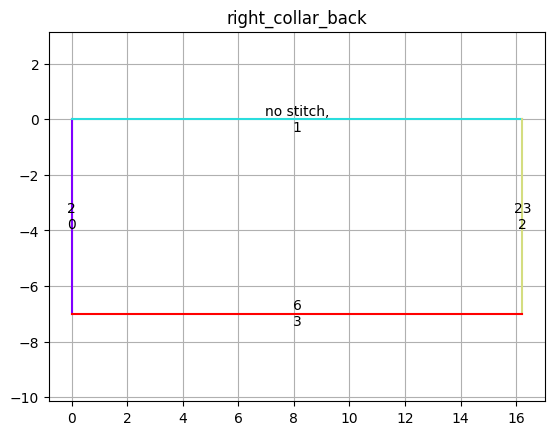

Path(Line(start=7j, end=0j),
     Line(start=0j, end=(16.226475637492708+0j)),
     Line(start=(16.226475637492708+0j), end=(16.226475637492708+7j)),
     Line(start=(16.226475637492708+7j), end=7j))


/home/hjp/anaconda3/envs/GarmentCode/lib/python3.9/site-packages/torch/functional.py:534: UserWarning:

torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)



SCALE FACTOR :  9.735885382495624


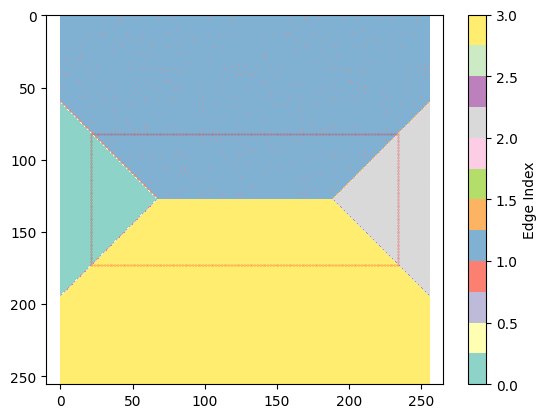

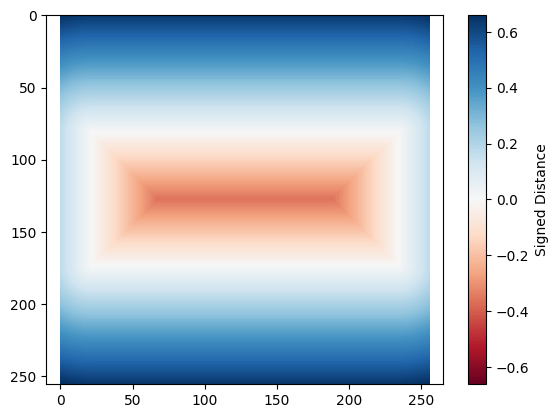

In [13]:
import svgpathtools
from svgpathtools import Path, Line
from matplotlib.colors import CenteredNorm
import time

def is_point_inside_path(path: Path, point: complex) -> bool:
    """
    Determine if a point is inside the path using ray casting.
    """
    ray_end = point + 1000 + 0j  # Cast ray in positive x direction
    intersections = 0
    
    for segment in path:
        ray = Line(point, ray_end)
        crossings = segment.intersect(ray)
        # crossings returns list of (t1, t2) tuples
        # t1 is parameter for first curve, t2 for second curve
        # We only care about t1 values between 0 and 1
        intersections += sum(1 for t1, t2 in crossings if 0 <= t1 <= 1)
    
    return intersections % 2 == 1

def compute_signed_distance_grid(
    path: svgpathtools.Path,
    n_samples: int = 1000,
    grid_size: int = 200,
    SDF_DOMAIN_SIZE: float = 2,
    ZOOM_OUT_FACTOR: float = 1.2,
    K_NEIGHBORS: int = 5
) -> torch.Tensor:
    """
    Compute signed distance field for an SVG path.
    args :
        path : svgpathtools.Path
            unnormalized closed path
        n_samples : int, number of samples along the path

        img_size : int, size of the grid
    """
    edge_lengths = [segment.length() for segment in path]
    total_length = sum(edge_lengths)
    
    # Distribute points proportionally to edge lengths
    points_per_edge = [
        max(int(n_samples * length / total_length), 10)  # Ensure minimum 10 points per edge
        for length in edge_lengths
    ]
    
    edge_points = []
    for edge_idx, segment in enumerate(path):
        t_vals = torch.linspace(0, 1, points_per_edge[edge_idx])
        edge_samples = torch.tensor([
            [segment.point(t.item()).real, segment.point(t.item()).imag]
            for t in t_vals
        ])
        edge_points.append(edge_samples)
    
    # Combine all points and create edge index mapping
    boundary_points = torch.cat(edge_points, dim=0)
    edge_indices = torch.cat([
        torch.full((points_per_edge[i],), i, dtype=torch.int64)
        for i in range(len(path))
    ])
    
    # get bounding box of the path
    xmin, xmax, ymin, ymax = path.bbox()
    x_center = (xmin + xmax) / 2
    y_center = (ymin + ymax) / 2
    x_scale = xmax - xmin
    y_scale = ymax - ymin
    
    scale_factor = max(x_scale, y_scale) * ZOOM_OUT_FACTOR / SDF_DOMAIN_SIZE
    
    boundary_points_normalized = (
        boundary_points - torch.tensor([x_center, y_center])
    ) / scale_factor
     
    # get grid of evaluation points
    coords = torch.stack(torch.meshgrid(
        torch.linspace(-1, 1, grid_size),
        torch.linspace(-1, 1, grid_size)
    ), dim=-1).reshape(-1, 2)[:, [1, 0]].float()
    
    # Compute unsigned distances
    coords_expanded = coords.unsqueeze(1)
    points_expanded = boundary_points_normalized.unsqueeze(0)
    distances = torch.norm(coords_expanded - points_expanded, dim=2)
    unsigned_distances, min_indices = torch.min(distances, dim=1)
    
    k_distances, k_indices = torch.topk(
        distances, k=K_NEIGHBORS, dim=1, largest=False
    )
    k_edge_indices = edge_indices[k_indices]
    weights = 1.0 / (k_distances + 1e-6)

    n_edges = len(path)

    one_hot = torch.zeros(
        k_edge_indices.shape[0], K_NEIGHBORS, n_edges
    )
    one_hot.scatter_(2, k_edge_indices.unsqueeze(-1), 1)
    
    # Apply weights to votes
    weighted_votes = one_hot * weights.unsqueeze(-1)
    
    # Sum votes for each edge
    edge_votes = weighted_votes.sum(dim=1)
    
    # Get edge with maximum votes
    closest_edge_indices = edge_votes.argmax(dim=1)
    
    # closest_edge_indices = edge_indices[min_indices]
    
    # For sign computation, transform coords back to original space
    signs = torch.tensor([
        -1 if is_point_inside_path(
            path, complex(x.item(), y.item())
        ) else 1
        for x, y in coords * scale_factor + torch.tensor([x_center, y_center])
    ])
    signed_distances = unsigned_distances * signs
    
    return (
        signed_distances.reshape(grid_size, grid_size),
        closest_edge_indices.reshape(grid_size, grid_size),
        scale_factor
    )

IMG_SIZE = 256
N_SAMPLES = 4000
PATH_IDX = 2

panel_name = pattern.panel_order()[PATH_IDX]
panel_svg_path = panel_svg_path_dict[panel_name][0]

fig, ax = plt.subplots()
ax.set_title(f"{panel_name}")
plot_panel_info(
    ax, panel_name,
    panel_svg_path_dict,
    stitch_dict,
    N_SAMPLES=1000
)
plt.show()

pprint(panel_svg_path)

sd_grid, edge_indices_grid, scale_factor = compute_signed_distance_grid(
    panel_svg_path,
    n_samples=N_SAMPLES,
    grid_size=IMG_SIZE
)

print("SCALE FACTOR : ", scale_factor)

THRESHOLD = 0.005
grid_np = sd_grid.cpu().numpy()
boundary_mask = np.logical_and(grid_np < THRESHOLD, grid_np > -THRESHOLD)
boundary_y, boundary_x = np.where(boundary_mask)



plt.imshow(edge_indices_grid.cpu().numpy(), cmap='Set3')
plt.colorbar(label='Edge Index')
plt.scatter(boundary_x, boundary_y, c='r', s=0.01)
plt.axis('equal')
plt.show()

plt.imshow(grid_np, cmap='RdBu', norm=CenteredNorm())
plt.colorbar(label='Signed Distance')
plt.axis('equal')
# plt.scatter(boundary_x, boundary_y, c='r', s=0.01)
plt.show()
